# Importing Libraries

In [1]:
import os as os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,roc_auc_score,auc,roc_curve
from sklearn.model_selection import RandomizedSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn import tree
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score,cross_validate

# Importing Data

In [2]:
os.chdir("D:\Edwisor\Project\Santander project")

In [3]:
os.getcwd()

'D:\\Edwisor\\Project\\Santander project'

In [4]:
train=pd.read_csv("train.csv", encoding="latin1")
test= pd.read_csv("test.csv",encoding="latin1")

In [5]:
train_main=train.copy()
test_main=test.copy()

# Understanding and Visualization the Data

In [6]:
train[0:5]

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104


In [8]:
test[0:5]

,ID_code,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,test_0,11.0656,7.7798,12.9536,9.4292,11.4327,-2.3805,5.8493,18.2675,2.1337,...,-2.1556,11.8495,-1.4300,2.4508,13.7112,2.4669,4.3654,10.7200,15.4722,-8.7197
1,test_1,8.5304,1.2543,11.3047,5.1858,9.1974,-4.0117,6.0196,18.6316,-4.4131,...,10.6165,8.8349,0.9403,10.1282,15.5765,0.4773,-1.4852,9.8714,19.1293,-20.9760
2,test_2,5.4827,-10.3581,10.1407,7.0479,10.2628,9.8052,4.8950,20.2537,1.5233,...,-0.7484,10.9935,1.9803,2.1800,12.9813,2.1281,-7.1086,7.0618,19.8956,-23.1794
3,test_3,8.5374,-1.3222,12.0220,6.5749,8.8458,3.1744,4.9397,20.5660,3.3755,...,9.5702,9.0766,1.6580,3.5813,15.1874,3.1656,3.9567,9.2295,13.0168,-4.2108
4,test_4,11.7058,-0.1327,14.1295,7.7506,9.1035,-8.5848,6.8595,10.6048,2.9890,...,4.2259,9.1723,1.2835,3.3778,19.5542,-0.2860,-5.1612,7.2882,13.9260,-9.1846


In [9]:
train.info(), test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 201 entries, ID_code to var_199
dtypes: float64(200), object(1)
memory usage: 306.7+ MB


(None, None)

In [10]:
train.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,0.100490,10.679914,-1.627622,10.715192,6.796529,11.078333,-5.065317,5.408949,16.545850,0.284162,...,3.234440,7.438408,1.927839,3.331774,17.993784,-0.142088,2.303335,8.908158,15.870720,-3.326537
std,0.300653,3.040051,4.050044,2.640894,2.043319,1.623150,7.863267,0.866607,3.418076,3.332634,...,4.559922,3.023272,1.478423,3.992030,3.135162,1.429372,5.454369,0.921625,3.010945,10.438015
min,0.000000,0.408400,-15.043400,2.117100,-0.040200,5.074800,-32.562600,2.347300,5.349700,-10.505500,...,-14.093300,-2.691700,-3.814500,-11.783400,8.694400,-5.261000,-14.209600,5.960600,6.299300,-38.852800
25%,0.000000,8.453850,-4.740025,8.722475,5.254075,9.883175,-11.200350,4.767700,13.943800,-2.317800,...,-0.058825,5.157400,0.889775,0.584600,15.629800,-1.170700,-1.946925,8.252800,13.829700,-11.208475
50%,0.000000,10.524750,-1.608050,10.580000,6.825000,11.108250,-4.833150,5.385100,16.456800,0.393700,...,3.203600,7.347750,1.901300,3.396350,17.957950,-0.172700,2.408900,8.888200,15.934050,-2.819550
75%,0.000000,12.758200,1.358625,12.516700,8.324100,12.261125,0.924800,6.003000,19.102900,2.937900,...,6.406200,9.512525,2.949500,6.205800,20.396525,0.829600,6.556725,9.593300,18.064725,4.836800
max,1.000000,20.315000,10.376800,19.353000,13.188300,16.671400,17.251600,8.447700,27.691800,10.151300,...,18.440900,16.716500,8.402400,18.281800,27.928800,4.272900,18.321500,12.000400,26.079100,28.500700


In [11]:
test.describe()

,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,10.658737,-1.624244,10.707452,6.788214,11.076399,-5.050558,5.415164,16.529143,0.277135,7.569407,...,3.189766,7.458269,1.925944,3.322016,17.996967,-0.133657,2.290899,8.912428,15.869184,-3.246342
std,3.036716,4.040509,2.633888,2.052724,1.616456,7.869293,0.864686,3.424482,3.333375,1.231865,...,4.551239,3.025189,1.479966,3.995599,3.140652,1.429678,5.446346,0.920904,3.008717,10.398589
min,0.188700,-15.043400,2.355200,-0.022400,5.484400,-27.767000,2.216400,5.713700,-9.956000,4.243300,...,-14.093300,-2.407000,-3.340900,-11.413100,9.382800,-4.911900,-13.944200,6.169600,6.584000,-39.457800
25%,8.442975,-4.700125,8.735600,5.230500,9.891075,-11.201400,4.772600,13.933900,-2.303900,6.623800,...,-0.095000,5.166500,0.882975,0.587600,15.634775,-1.160700,-1.948600,8.260075,13.847275,-11.124000
50%,10.513800,-1.590500,10.560700,6.822350,11.099750,-4.834100,5.391600,16.422700,0.372000,7.632000,...,3.162400,7.379000,1.892600,3.428500,17.977600,-0.162000,2.403600,8.892800,15.943400,-2.725950
75%,12.739600,1.343400,12.495025,8.327600,12.253400,0.942575,6.005800,19.094550,2.930025,8.584825,...,6.336475,9.531100,2.956000,6.174200,20.391725,0.837900,6.519800,9.595900,18.045200,4.935400
max,22.323400,9.385100,18.714100,13.142000,16.037100,17.253700,8.302500,28.292800,9.665500,11.003600,...,20.359000,16.716500,8.005000,17.632600,27.947800,4.545400,15.920700,12.275800,26.538400,27.907400


# Observation from above table
 1) standard deviation is relatively large for both train and test variable data.
 2) mean, std, min, max values for train and test data looks quite close.
 3) Mean values are distributed over a large range.

# Data Preprocessing

#Checking for Missing values

In [14]:
train.isnull().sum().sum()

0

In [15]:
test.isnull().sum().sum()

0

Data have no missing points

# Outlier Analysis

Box plot for Outlier Analysis


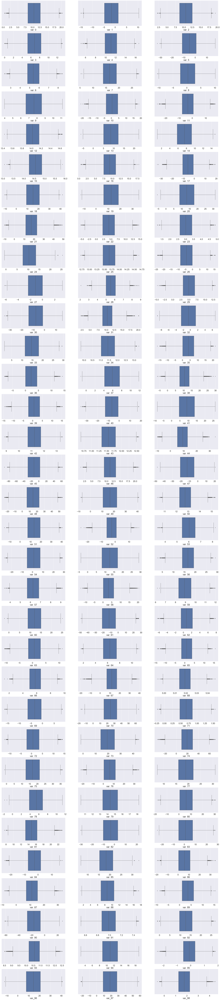

In [6]:
sns.set_style("whitegrid")
plt.figure(figsize=(50,500))
sns.set(font_scale=2.5)
numeric=train.columns[2:101]
print("Box plot for Outlier Analysis")
for i,col in enumerate(numeric):
    plt.subplot(70,3,i+1)
    sns.boxplot(x=train[col])

Box plot for Outlier Analysis


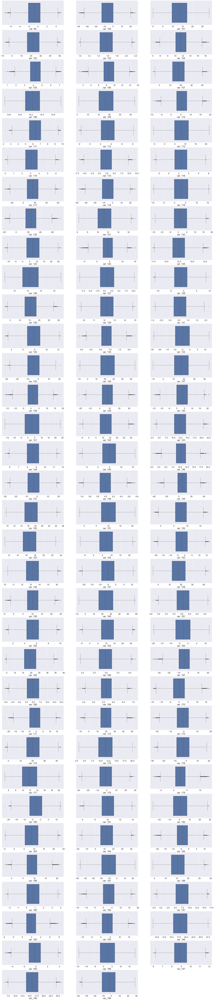

In [7]:
sns.set_style("whitegrid")
plt.figure(figsize=(50,500))
sns.set(font_scale=2.5)
numeric=train.columns[101:]
print("Box plot for Outlier Analysis")
for i,col in enumerate(numeric):
    plt.subplot(70,3,i+1)
    sns.boxplot(x=train[col])

#Replacing Outliers with NA in data set

In [6]:
numeric=train.columns[2:]
for i in numeric:
    q75, q25 = np.percentile(train_main.loc[:,i], [75 ,25])
    iqr = q75 - q25

    minimum = q25 - (iqr*1.5)
    maximum = q75 + (iqr*1.5)
    
    train.loc[train[i] < minimum,i]= np.nan
    train.loc[train[i] > maximum,i]= np.nan

In [7]:
train.isnull().sum().sum()

26536

In [8]:
train.isnull().mean()*100

ID_code    0.0000
target     0.0000
var_0      0.0520
var_1      0.0030
var_2      0.0245
            ...  
var_195    0.0660
var_196    0.0000
var_197    0.0255
var_198    0.0470
var_199    0.0100
Length: 202, dtype: float64

In [8]:
 #Filling NA with mean
for i in numeric:
    train.loc[:,i]=train.loc[:,i].fillna(train.loc[:,i].mean())

In [9]:
train.isnull().sum().sum()

0

# Dimensionality Reduction 

## Correlation plot

In [10]:
df=train.drop(["ID_code"],axis=1)

In [11]:
df[1:5]

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,-4.9193,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,-5.8609,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,6.2654,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
5,0,11.4763,-2.3182,12.6080,8.6264,10.9621,3.5609,4.5322,15.2255,3.5855,...,-6.3068,6.6025,5.2912,0.4403,14.9452,1.0314,-3.6241,9.7670,12.5809,-4.7602


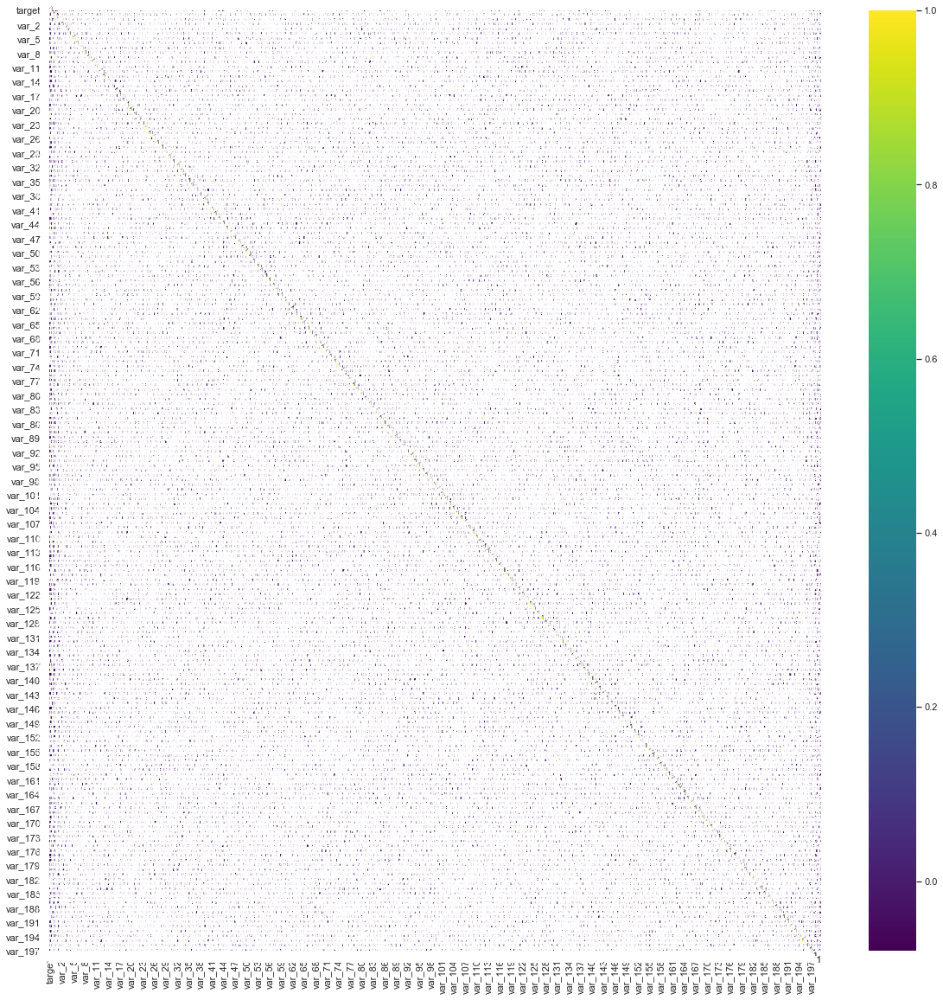

In [12]:
plt.figure(figsize=(20,20))
sns.set(font_scale=1)
corr=df.corr()
ax=sns.heatmap(corr,cmap="viridis",annot=True)

In [13]:
np.fill_diagonal(corr.values,np.nan)
corr.max().max(),corr.min().min()

(0.06761227441298684, -0.08010930562006832)

We have aroung 201 feature and all are not correlated with each other.

### PCA

In [146]:
standardized_train= train.set_index(["ID_code","target"])

In [148]:
numeric=standardized_train.columns[:]
for i in numeric:
    standardized_train[i]=((standardized_train[i]-standardized_train[i].mean())/standardized_train[i].std())
    

In [149]:
pca= PCA()

In [151]:
pca.fit_transform(standardized_train)

array([[-0.38458769, -0.66129363,  0.23138258, ...,  0.03498139,
        -1.10734016,  0.84577449],
       [-0.11682003,  0.23086363, -0.08938475, ...,  0.39245132,
        -0.93784045,  0.03289047],
       [ 1.30584025, -0.64318602,  0.83371838, ..., -1.90595655,
         1.83324472,  0.24914377],
       ...,
       [-0.05731213,  1.98581982, -0.24621714, ...,  0.38271229,
         2.17886967, -0.85085134],
       [ 0.71350705,  0.78691983,  0.97185534, ...,  0.21143659,
        -0.93112653,  0.49035709],
       [-1.39104609,  0.00455972,  1.67803355, ..., -0.21519595,
         0.67598155,  0.28883284]])

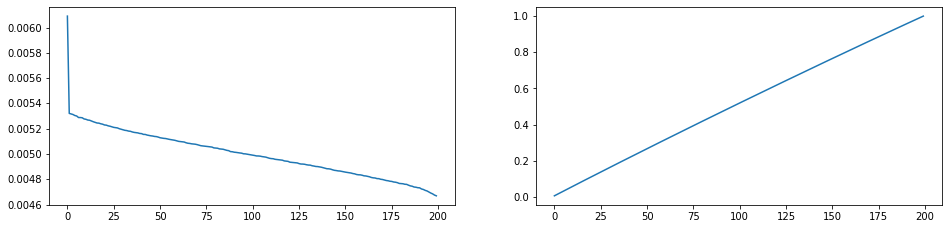

In [158]:
#lets plot the explained variance curve
plt.figure(figsize=(16,8))
plt.subplot(221)
plt.plot(pca.explained_variance_ratio_)
plt.subplot(222)
plt.plot(np.cumsum(pca.explained_variance_ratio_))

#### The line of cumulative sums of explained variance ratio when you PCA the data set, it is indicative of a dataset that has already undergone PCA (get straight line ie y=x).

### Random forest 

In [18]:
X=train.drop(["target"],axis=1)
Y=train["target"]

In [24]:
X= X.set_index(["ID_code"])

In [25]:
#Dividing data in train and test subsets
x_train,x_test,y_train,y_test= train_test_split(X,Y, test_size=0.2)
print(train.shape,x_train.shape,x_test.shape,y_train.shape,y_test.shape)

(175104, 202) (140083, 200) (35021, 200) (140083,) (35021,)


In [27]:
forest=RandomForestClassifier(n_estimators=100)
forest.fit(x_train,y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [38]:
labels= x_train.columns[1:]

In [56]:
importance=forest.feature_importances_
a= np.argsort(importance)[::-1]

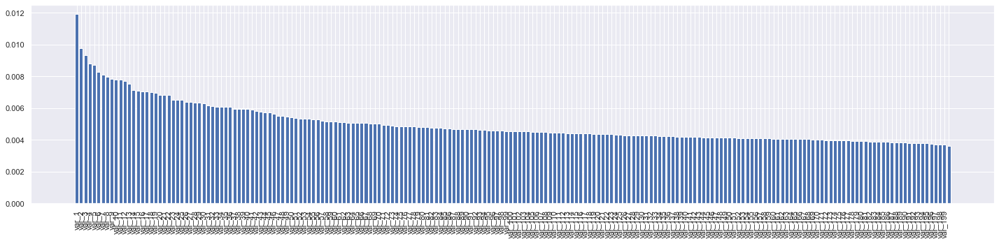

In [58]:
plt.figure(figsize=(20,5))
plt.bar(range(x_train.shape[1]),importance[a])
plt.xticks(range(x_train.shape[1]),labels,rotation=90)
plt.tight_layout()

As we can observe no feature have such low importance that we can drop it. so we have to go with all 200 features

# Understanding data variable in train and test

In [6]:
train["target"], train["ID_code"]

(0         0
 1         0
 2         0
 3         0
 4         0
          ..
 199995    0
 199996    0
 199997    0
 199998    0
 199999    0
 Name: target, Length: 200000, dtype: int64, 0              train_0
 1              train_1
 2              train_2
 3              train_3
 4              train_4
               ...     
 199995    train_199995
 199996    train_199996
 199997    train_199997
 199998    train_199998
 199999    train_199999
 Name: ID_code, Length: 200000, dtype: object)

In [7]:
#Target variable
train["target"].value_counts()

0    179902
1     20098
Name: target, dtype: int64

Train and test data almost have same distribution for variables, variable mean and std.

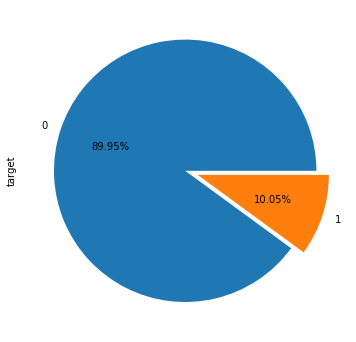

In [13]:
#Visualizing target variable
plt.figure(figsize=(5,5))
train["target"].value_counts().plot(kind="pie",autopct='%.2f%%',explode=(0,0.1))
plt.tight_layout()

We can see that our data is imbalance. 

### Problems with imbalance data and how to deal with them 

Due to imbalancing in data over model false prediction rate increaces toward high percentage class in this case as our no class (i.e. 0 ) is 89.95 % our model will have high false negative rate. so here are some methods to deal with imbalancing:


##### 1)Random under sampling: Randomly eliminating majority class ( we cannot use this as we may loss some important information)
##### 2)Random over-sampling: Randomly replicating cases of minority class ( this may cause overfitting)
##### 3)SMOTE: Exact replicas of minority class is added to main dataset ( It is not effective with high dimensional data)
##### 4) Ensemble Techniques: using Bagging and boosting bases techniques ( Gradient boost techniques)

We will try to solve this with Ensemble Techniques by using GBM. In order to try to built a satisfactory model with base algo. we try hyper parameter tunning

### Some visualization in order to compair  test and train data

In [13]:
#Now lets see how numerical varaiables in traine data distributed
sns.set_style("whitegrid")
plt.figure(figsize=(50,500))
sns.set(font_scale=2.5)
numeric=train.columns[2:]
print("Distribution of Columns")
for i,col in enumerate(numeric):
    plt.subplot(70,3,i+1)
    sns.distplot(train[col],color="blue",bins=10)

Distribution of Columns


Almost all these features in train data set have normal distribution

In [14]:
#Now lets see how numerical varaiables in traine data varies for different class of target variable
sns.set_style("whitegrid")
plt.figure(figsize=(50,500))
sns.set(font_scale=2.5)
numeric=train.columns[2:]
print("Distribution of Columns with different class of target variable")
for i,col in enumerate(numeric):
    plt.subplot(70,3,i+1)
    sns.distplot(train[train["target"]==0][col],hist=False,color="red",label="0")
    sns.distplot(train[train["target"]==1][col],hist=False,color="black",label="1")

Distribution of Columns with different class of target variable


In [15]:
#Let see how numeric variables are varing in train and test data set
sns.set_style("whitegrid")
plt.figure(figsize=(50,500))
sns.set(font_scale=2.5)
numeric=train.columns[2:]
print("Distribution of Columns with different class of target variable")
for i,col in enumerate(numeric):
    plt.subplot(70,3,i+1)
    sns.distplot(train[col],hist=False,label='train',color='red')
    sns.distplot(test[col],hist=False,label='test',color='green')

Distribution of Columns with different class of target variable


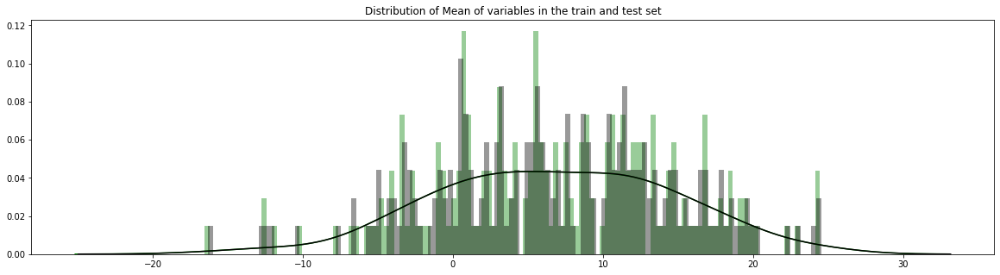

In [84]:
plt.figure(figsize=(20,5))
features = train.columns.values[2:202]
plt.title("Distribution of Mean of variables in the train and test set")
sns.distplot(train[features].mean(axis=0),color="green",kde=True,bins=120, label='train')
sns.distplot(test[features].mean(axis=0),color="Black", kde=True,bins=120, label='test')
plt.show()

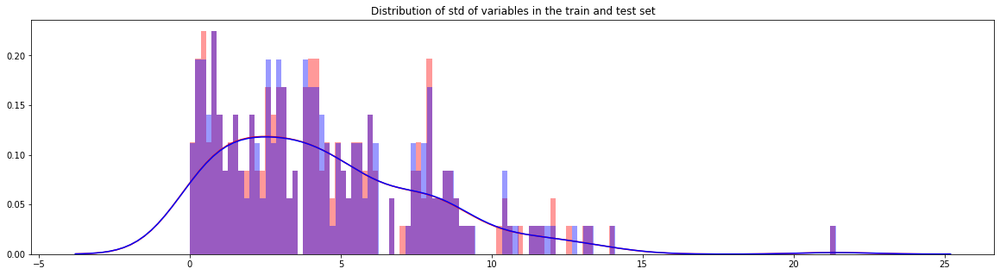

In [93]:
plt.figure(figsize=(20,5))
features = train.columns.values[2:202]
plt.title("Distribution of std of variables in the train and test set")
sns.distplot(train[features].std(axis=0),color="red",kde=True,bins=120, label='train')
sns.distplot(test[features].std(axis=0),color="Blue", kde=True,bins=120, label='test')
plt.show()

# Feature scaling

#### As we find out that all the numerical variable is normally distributed we can do standardizaation on data 

In [10]:
fs_train= train.set_index(["ID_code","target"])
numeric=fs_train.columns[:]
for i in numeric:
    fs_train[i]=((fs_train[i]-fs_train[i].mean())/fs_train[i].std())

In [11]:
fs_test= test.set_index(["ID_code"]) 
numeric_test=fs_test.columns[:]
for i in numeric:
    fs_test[i]=((fs_test[i]-fs_test[i].mean())/fs_test[i].std())

In [33]:
fs_train.head()

,,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
ID_code,target,,,,,,,,,,,,,,,,,,,,,
train_0,0,-0.578230,-1.274015,0.452532,-0.834316,0.235039,-0.536551,-0.335608,0.609261,-1.561688,-1.473792,...,0.262817,-1.150511,0.835727,-0.418763,0.168744,-1.584274,1.022128,-0.373932,-1.028124,0.213924
train_1,0,0.270734,-0.622322,1.191958,-0.689376,0.791454,1.539995,0.245256,-0.003295,0.858984,0.419299,...,0.968744,0.094395,0.455382,1.925489,-0.817601,1.525324,1.067651,-0.129074,0.827490,0.505622
train_2,0,-0.682476,-0.276200,0.517881,0.536642,-0.306995,-0.511151,1.774522,-0.564776,-1.561478,-1.307405,...,-0.073933,0.779969,-0.173113,-0.420080,1.151675,2.302635,-1.617902,-0.695485,-0.381852,0.356543
train_3,0,0.125608,-0.129538,-0.667923,0.195298,0.928721,0.410650,0.502081,-0.474187,-1.844032,0.548765,...,0.269685,-0.892365,-0.828654,-0.487011,1.607974,-0.793350,-0.959017,1.504001,0.698928,-0.544096
train_4,0,-0.277758,0.035521,0.818890,-0.078031,0.738991,0.955608,0.615107,0.792139,1.794808,0.090006,...,-1.041718,0.690806,-1.426388,1.480616,-1.501139,-0.962804,0.297626,0.646781,0.708147,-0.525961


# Spliting data in Independent and dependent variable

In [12]:
final_train=fs_train.reset_index()
final_test= fs_test.reset_index()
final_test=final_test.set_index(["ID_code"])
final_train=final_train.set_index(["ID_code"])

In [13]:
final_train.head()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
ID_code,,,,,,,,,,,,,,,,,,,,,
train_0,0,-0.578230,-1.274015,0.452532,-0.834316,0.235039,-0.536551,-0.335608,0.609261,-1.561688,...,0.262817,-1.150511,0.835727,-0.418763,0.168744,-1.584274,1.022128,-0.373932,-1.028124,0.213924
train_1,0,0.270734,-0.622322,1.191958,-0.689376,0.791454,1.539995,0.245256,-0.003295,0.858984,...,0.968744,0.094395,0.455382,1.925489,-0.817601,1.525324,1.067651,-0.129074,0.827490,0.505622
train_2,0,-0.682476,-0.276200,0.517881,0.536642,-0.306995,-0.511151,1.774522,-0.564776,-1.561478,...,-0.073933,0.779969,-0.173113,-0.420080,1.151675,2.302635,-1.617902,-0.695485,-0.381852,0.356543
train_3,0,0.125608,-0.129538,-0.667923,0.195298,0.928721,0.410650,0.502081,-0.474187,-1.844032,...,0.269685,-0.892365,-0.828654,-0.487011,1.607974,-0.793350,-0.959017,1.504001,0.698928,-0.544096
train_4,0,-0.277758,0.035521,0.818890,-0.078031,0.738991,0.955608,0.615107,0.792139,1.794808,...,-1.041718,0.690806,-1.426388,1.480616,-1.501139,-0.962804,0.297626,0.646781,0.708147,-0.525961


In [14]:
X=final_train.drop(["target"],axis=1)
Y=final_train["target"]

In [15]:
X.shape

((200000, 200), (200000,))

## Defininf function for Model Interpretation

In [16]:
def model_results(model, X, Y, model_name):
    print(model_name)
    y_pred=model.predict(X)
    CM =pd.crosstab(Y,y_pred)
    print(CM)
    TN=CM.iloc[0,0]
    FN= CM.iloc[1,0]
    TP=CM.iloc[1,1]
    FP= CM.iloc[0,1]
    #ACCURACY,RECALL,PRECISION,SPECIFICITY
    A= (TP+TN)/(TP+TN+FP+FN)
    P=(TP)/(TP+FP)
    R=(TP)/(TP+FN)
    S= (TN)/(TN+FP)
    FPR =(FP)/(FP+TN)
    FNR =(FN)/(FN+TP)
    print(("Accuracy:", A), ("Precision:",P),("Recall:",R),("Specificity:",S),
          ("False positive rate",FPR),("False negative rate",FNR))  
    #ROC_AUC_SCORE & CURVE
    fpr, tpr, thresholds =roc_curve(Y,y_pred)
    plt.plot(fpr, tpr)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.title("ROC curve")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.grid(True)
    plt.show()
    print('AUC: %.3f' % auc(fpr,tpr))
  
  

# Model Building and Hyper parameter tunning

### Algorithm we are going to use: 1) Logistic Regression, 2) Naive baye, 3) Decesion Tree, 4) Random forest, 5) Boosted Tree algorithm: XGBoost/Light GBM (only one of these two)

# 1) Logistic Regression

In [102]:
LR= LogisticRegression()
LR_model= LR.fit(X,Y)

Logistric Model
col_0        0     1
target              
0       177485  2417
1        14705  5393
('Accuracy:', 0.91439) ('Precision:', 0.6905249679897567) ('Recall:', 0.268335157727137) ('Specificity:', 0.9865649075607831) ('False positive rate', 0.013435092439216907) ('False negative rate', 0.731664842272863)


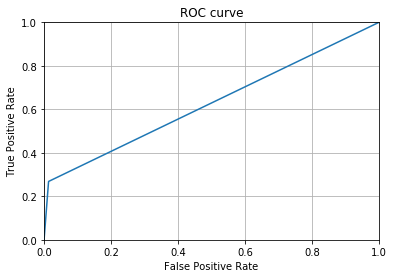

AUC: 0.627


In [103]:
model_results(LR_model,X,Y, "Logistric Model")

ROC_score is low, false negative rate is high (14705) and false positive rate is also (2417). 

#### Hyperparameter tunning for Logistic regression

In [104]:
penalty = ['l1', 'l2']
C=np.logspace(-4, 4, 10)
class_weight=['balanced'] 
hyperparameters = dict(C=C, penalty=penalty, class_weight= class_weight, max_iter=[5,10,15,20])

In [105]:
LR_rand = RandomizedSearchCV(estimator= LR, param_distributions= hyperparameters,
                             cv=5, scoring="roc_auc", n_iter=10, random_state=42)
LR_rand.fit(X,Y)
print("roc_best:", LR_rand.best_score_)
print("best_parameters:",LR_rand.best_params_)

C:\Users\hp\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  FitFailedWarning)
C:\Users\hp\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  FitFailedWarning)


roc_best: 0.8583850003950882
best_parameters: {'penalty': 'l2', 'max_iter': 20, 'class_weight': 'balanced', 'C': 0.046415888336127774}


In [106]:
# Model with best parameter
LR= LogisticRegression(penalty="l2", max_iter=20, class_weight="balanced",C=0.046415888336127774,random_state=42)
LR_model_hyper= LR.fit(X,Y)

Logistric Model
col_0        0      1
target               
0       140529  39373
1         4410  15688
('Accuracy:', 0.781085) ('Precision:', 0.2849203610541036) ('Recall:', 0.7805751816101104) ('Specificity:', 0.781141955064424) ('False positive rate', 0.21885804493557603) ('False negative rate', 0.21942481838988953)


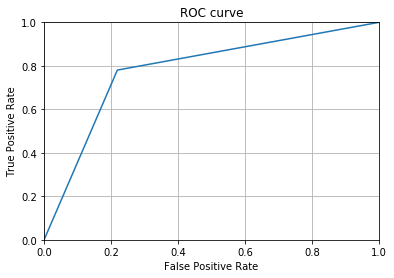

AUC: 0.781


In [107]:
model_results(LR_model_hyper,X,Y, "Logistric Model")

False Negative rate is high i.e. 39373

In [108]:
#Checking model is overfitting or not
logit_scores = cross_validate(LR_model_hyper, x_train, y_train, cv=10, scoring=['accuracy','precision','recall','roc_auc'],)
pd.DataFrame(logit_scores).mean()

fit_time          0.945088
score_time        0.035930
test_accuracy     0.780600
test_precision    0.283868
test_recall       0.776892
test_roc_auc      0.858603
dtype: float64

# 2) Naive baye

In [109]:
NB=GaussianNB()
NB_model=NB.fit(X,Y)

Naive baye Model
col_0        0     1
target              
0       177043  2859
1        12814  7284
('Accuracy:', 0.921635) ('Precision:', 0.7181307305530908) ('Recall:', 0.36242412180316447) ('Specificity:', 0.9841080143633756) ('False positive rate', 0.015891985636624386) ('False negative rate', 0.6375758781968355)


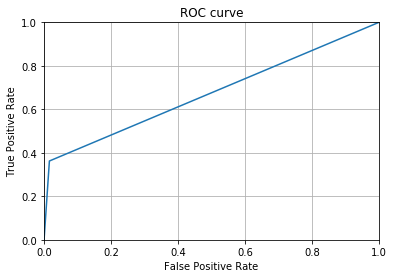

AUC: 0.673


In [110]:
model_results(NB_model,X,Y, "Naive baye Model")

Accuracy is quite good for this model but still the False negative number is 12814 which is high or low recall. and also false positive rate ia 2859 which is also high or precision is low. This model is also not acceptable. Lets do parameter tunning for Naive baye

#### Hyper parameter tunning for Naive baye

In [22]:
NB=GaussianNB()
hyperparameter = dict( var_smoothing =np.logspace(0,-9, num=20))
NB_rand = RandomizedSearchCV(estimator=NB, param_distributions=hyperparameter, cv=5, 
                             scoring="roc_auc", n_iter=10,random_state=42)
NB_model_hyper=NB_rand.fit(X,Y)
print("roc_best:", NB_rand.best_score_)
print("best_parameters:",NB_rand.best_params_)

roc_best: 0.8876100358400765
best_parameters: {'var_smoothing': 8.858667904100832e-09}


In [23]:
NB= GaussianNB(var_smoothing= 8.858667904100832e-09)
NB_model_hyper=NB.fit(X,Y)

Naive baye Model
col_0        0     1
target              
0       177043  2859
1        12814  7284
('Accuracy:', 0.921635) ('Precision:', 0.7181307305530908) ('Recall:', 0.36242412180316447) ('Specificity:', 0.9841080143633756) ('False positive rate', 0.015891985636624386) ('False negative rate', 0.6375758781968355)


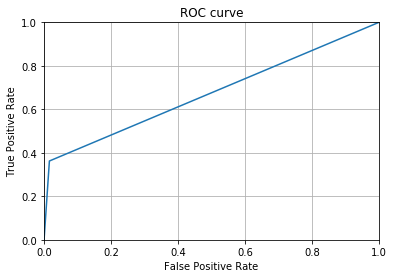

AUC: 0.673


In [24]:
model_results(NB_model_hyper,X,Y, "Naive baye Model")

No effect in model results

# 3) Decision Tree

In [27]:
DT=tree.DecisionTreeClassifier(class_weight="balanced", random_state=42)
DT_model = DT.fit(X,Y)

Decision Tree Model
col_0        0      1
target               
0       179902      0
1            0  20098
('Accuracy:', 1.0) ('Precision:', 1.0) ('Recall:', 1.0) ('Specificity:', 1.0) ('False positive rate', 0.0) ('False negative rate', 0.0)


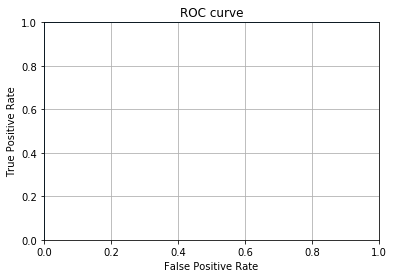

AUC: 1.000


In [28]:
model_results(DT_model,X,Y, "Decision Tree Model")

The model may be overfetted here lets check

In [29]:
#Checking model is overfitting or not
DT_scores = cross_validate(DT_model, X,Y, cv=10, scoring=['accuracy','precision','recall','roc_auc'],)
pd.DataFrame(DT_scores).mean()

fit_time          79.994694
score_time         0.089602
test_accuracy      0.827365
test_precision     0.161610
test_recall        0.171261
test_roc_auc       0.535962
dtype: float64

we can clearly see that the model is overfitting. Lets do hyper parameter tunning in order to improve model 

#### Hyper parameter tunning in Decision tree

In [31]:
DT=tree.DecisionTreeClassifier()
hyperparameter =dict(criterion= ['gini', 'entropy'],
             max_depth= [1, 2, 3, 4, 5],
             min_samples_split= [2, 3] ,class_weight=['balanced' ,None] )

# randomized search for given model parameter
DT_rand = RandomizedSearchCV(estimator=DT, param_distributions=hyperparameter, cv=5, scoring='roc_auc', n_iter=10, 
                          random_state=42,n_jobs=-1)
DT_model_hyper=DT_rand.fit(X,Y)
print("roc_best:", DT_model_hyper.best_score_)
print("best_parameters:",DT_model_hyper.best_params_)

roc_best: 0.6363780913982167
best_parameters: {'min_samples_split': 3, 'max_depth': 5, 'criterion': 'entropy', 'class_weight': 'balanced'}


In [34]:
DT=tree.DecisionTreeClassifier(criterion="entropy", max_depth=5,min_samples_split=3,class_weight="balanced")
DT_model_hyper= DT.fit(X,Y)

Decision Tree Model
col_0        0      1
target               
0       125280  54622
1         9441  10657
('Accuracy:', 0.679685) ('Precision:', 0.16325311355872485) ('Recall:', 0.5302517663449099) ('Specificity:', 0.696379139753866) ('False positive rate', 0.303620860246134) ('False negative rate', 0.46974823365509005)


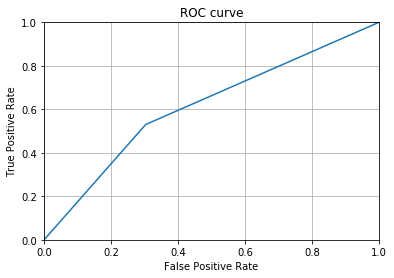

AUC: 0.613


In [36]:
model_results(DT_model_hyper,X,Y, "Decision Tree Model")

Still ROC score is .613 , False positive rate and false negative rate is very very high. Model is not acceptable 

# 4) Random Forest

In [37]:
forest=RandomForestClassifier(n_estimators=100)
RF_model=forest.fit(X,Y)

Random forest Model
col_0        0      1
target               
0       179902      0
1            3  20095
('Accuracy:', 0.999985) ('Precision:', 1.0) ('Recall:', 0.9998507314160613) ('Specificity:', 1.0) ('False positive rate', 0.0) ('False negative rate', 0.00014926858393870038)


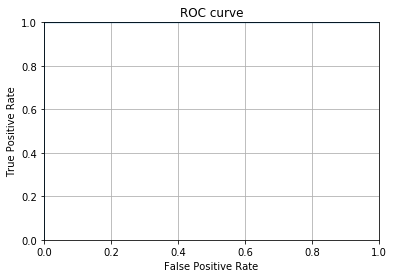

AUC: 1.000


In [38]:
model_results(RF_model,X,Y, "Random forest Model")

Model May be overfitting lets check it with cross validation

In [39]:
#Checking model is overfitting or not
RF_scores = cross_validate(RF_model, X,Y, cv=10, scoring=['accuracy','precision','recall','roc_auc'],)
pd.DataFrame(RF_scores).mean()

C:\Users\hp\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\hp\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\hp\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\hp\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision is ill-defin

fit_time          644.582500
score_time          2.556115
test_accuracy       0.899535
test_precision      0.500000
test_recall         0.000249
test_roc_auc        0.821880
dtype: float64

#### Hyper parameter tunning in random forest

In [ ]:
forest = RandomForestClassifier()
hyperparameter = {'criterion': ['entropy', 'gini'],
               'max_depth': list(np.linspace(10, 1200, 10, dtype = int)) + [None],
               'max_features': ['auto', 'sqrt','log2', None],
               'min_samples_leaf': [4, 6, 8, 12],
               'min_samples_split': [5, 7, 10, 14],
               'n_estimators': list(np.linspace(151, 1200, 10, dtype = int))}
RF_rand= RandomizedSearchCV(estimator = forest, param_distributions = random_search, n_iter = 80, 
                               cv = 4, verbose= 5, random_state= 101, n_jobs = -1)
RF_model_hyper=RF_rand.fit(x_train, y_train)
print("roc_best:", RF_model_hyper.best_score_)
print("best_parameters:",RF_model_hyper.best_params_)

Fitting 4 folds for each of 80 candidates, totalling 320 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 16.0min


In [ ]:
forest= RandomForestClassifier(criterion="",max_depth=,max_features=,min_samples_leaf=,min_sample_split=,n_estimatoes=)
RF_model_hyper=forest.fit(x_train,y_train)

In [ ]:
model_results(RF_model_hyper,x_test,y_test, "Random forest Model")

# 5) XGBoost

In [15]:
xgb = XGBClassifier()
xgb_model=xgb.fit(X,Y)

XGB Model
col_0        0      1
target               
0       179587    315
1         8874  11224
('Accuracy:', 0.954055) ('Precision:', 0.9727012739405494) ('Recall:', 0.5584635287093244) ('Specificity:', 0.998249046703205) ('False positive rate', 0.0017509532967949217) ('False negative rate', 0.4415364712906757)


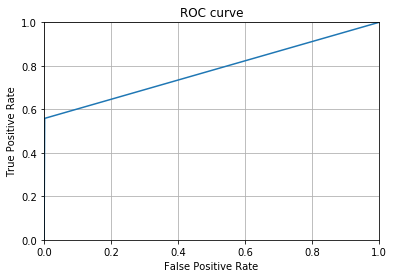

AUC: 0.778


In [18]:
model_results(xgb_model,X,Y, "XGB Model")

#### Hyper parameter tunning of XGBoost

In [20]:
xgb = XGBClassifier(learning_rate =0.1,n_estimators=800,max_depth=5,min_child_weight=1,gamma=0,subsample=0.8,
                    colsample_bytree=0.8,objective= 'binary:logistic',nthread=4,seed=27,scale_pos_weight=2)
xgb_model_hyper=xgb.fit(X,Y)

XGB Model
col_0        0      1
target               
0       178575   1327
1         4350  15748
('Accuracy:', 0.971615) ('Precision:', 0.9222840409956076) ('Recall:', 0.7835605532888845) ('Specificity:', 0.992623761825883) ('False positive rate', 0.00737623817411702) ('False negative rate', 0.21643944671111554)


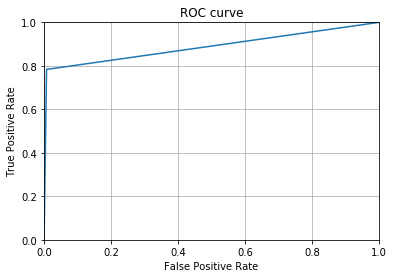

AUC: 0.888


In [21]:
model_results(xgb_model_hyper,X,Y, "XGB Model")

# Model Selection

In [44]:
Logistic_Model={'Accuracy':0.91439,'Precision':0.6905249679897567, 'Recall': 0.2683,'Specificity':0.9865,
                 'False positive rate':0.01343, 'False negative rate':0.73166,'AUC': 0.627}
Logistic_Model_hypertune={'Accuracy': 0.7810, 'Precision': 0.2849,'Recall':0.7805,'Specificity': 0.78114,
                             'False positive rate': 0.2188,'False negative rate':0.2194,'AUC':0.781}
Naive_Baye_Model={'Accuracy':0.9216,'Precision':0.7181,'Recall':0.3624,'Specificity':0.9841,'False positive rate':0.01589,
                  'False negative rate':0.6375,'AUC': 0.673}
Naive_Baye_hypertune={'Accuracy':0.9216,'Precision':0.7181,'Recall':0.3624,'Specificity':0.9841,'False positive rate':0.01589,
                  'False negative rate':0.6375,'AUC': 0.673}
Decision_Tree_hypertune={'Accuracy':0.6796,'Precision':0.16325,'Recall':0.53025,'Specificity':0.6963,
                         'False positive rate':0.30362,'False negative rate': 0.4697,'AUC':0.613}
XGBoost_Model={'Accuracy':0.95405,'Precision':0.97270,'Recall':0.55846,'Specificity':0.99824 ,'False positive rate':0.001750,
               'False negative rate':0.4415, 'AUC':0.778}
XGBoost_Model_hypertune={'Accuracy':0.971615,'Precision':0.92228,'Recall':0.78356,'Specificity':0.99262,
                         'False positive rate':0.00737,'False negative rate':0.21643,'AUC':0.888}

In [48]:
DF= pd.DataFrame([Logistic_Model,Logistic_Model_hypertune,Naive_Baye_Model,Naive_Baye_hypertune,Decision_Tree_hypertune,
                  XGBoost_Model,XGBoost_Model_hypertune] ,index=['LR','LRH','NB','NBH','DTH','XGB','XGBH'],
                  columns=['Accuracy','Precision','Recall','Specificity','False positive rate','False negative rate','AUC'])

#### Selecting Model which have:
1) High AUC
2) High Precision and Recall
3) Low False positive rate and False Negative rate

In [52]:
DF.sort_values(by="AUC", ascending=False)

,Accuracy,Precision,Recall,Specificity,False positive rate,False negative rate,AUC
XGBH,0.971615,0.922280,0.78356,0.99262,0.00737,0.21643,0.888
LRH,0.781000,0.284900,0.78050,0.78114,0.21880,0.21940,0.781
XGB,0.954050,0.972700,0.55846,0.99824,0.00175,0.44150,0.778
NB,0.921600,0.718100,0.36240,0.98410,0.01589,0.63750,0.673
NBH,0.921600,0.718100,0.36240,0.98410,0.01589,0.63750,0.673
LR,0.914390,0.690525,0.26830,0.98650,0.01343,0.73166,0.627
DTH,0.679600,0.163250,0.53025,0.69630,0.30362,0.46970,0.613


The XGBoost model in which we provided hyper parameter is have god AUC score of 0.88 & have precision and recall higher than other model, also FPR and FNR is lower than other model 

In [69]:
test["target"]=xgb_model_hyper.predict(final_test)

In [73]:
Final_results=test.drop(test.iloc[:,1:201],axis=1)

In [74]:
Final_results.head()

,ID_code,target
0,test_0,0
1,test_1,0
2,test_2,0
3,test_3,0
4,test_4,0


In [75]:
Final_results.to_csv("test_predicted_python.csv",index=False)